In [1]:
import requests
import pandas as pd
import re
import numpy as np
import json

import matplotlib.pyplot as plt
import matplotlib.cm
from mpl_toolkits.basemap import Basemap
from matplotlib.patches import Polygon
from matplotlib.collections import PatchCollection
from matplotlib.colors import Normalize
from itertools import chain
import pydeck as pdk

from SPARQLWrapper import SPARQLWrapper, JSON
import pandas as pd

import warnings
warnings.filterwarnings(action='ignore')

#!pip install SPARQLWrapper

In [8]:
### Create SPARQL query
### Resource: https://query.wikidata.org/

query1 = """
SELECT ?coordinates ?personLabel ?birthPlaceLabel ?birthDate ?wikipedia
WHERE {
  ?person wdt:P27 wd:Q212;  # Ukrainian nationality
          wdt:P19 ?birthPlace;  # Person has a birthplace
          wdt:P569 ?birthDate.

  ?birthPlace wdt:P625 ?coordinates.  # Get birthplace coordinates if available
  
  ?article schema:about ?person;

  OPTIONAL {
    ?ukWiki schema:about ?person;
            schema:isPartOf <https://uk.wikipedia.org/>.  # Ukrainian Wikipedia article
  }

  OPTIONAL {
    ?enWiki schema:about ?person;
            schema:isPartOf <https://en.wikipedia.org/>.  # English Wikipedia article
  }

  # Choose the Ukrainian Wikipedia link if available, otherwise fall back to English
  BIND(COALESCE(?ukWiki, ?enWiki) AS ?wikipedia)

  # Ensure birthdate is after 1800
  #FILTER(YEAR(?birthDate) >= 2000)

  # Ensure labels are returned in English or Ukrainian
  SERVICE wikibase:label { bd:serviceParam wikibase:language "uk,en". }
}
LIMIT 35000
"""

query2 = '''
SELECT ?person ?personLabel ?article ?birthPlaceLabel ?birthDate ?coordinates ?wikipedia WHERE {
  # Person is a Ukrainian nationality
  ?person wdt:P27 wd:Q212.
  
  # Person has a Ukrainian Wikipedia article
  ?wikipedia schema:about ?person;
           schema:isPartOf <https://uk.wikipedia.org/>.

  # Person has a birthPlace with coordinates
  ?person wdt:P19 ?birthPlace.
  ?birthPlace wdt:P625 ?coordinates.

  # Optional: Limit to people born after 1900 (change if needed)
  ?person wdt:P569 ?birthDate.
  #FILTER(YEAR(?birthDate) >= 2000)
  
  SERVICE wikibase:label { bd:serviceParam wikibase:language "uk,en". }
}
LIMIT 29000
'''

# Define SPARQL endpoint
sparql = SPARQLWrapper("https://query.wikidata.org/sparql")

headers = {
    "User-Agent": "MySPARQLQueryBot/1.0 (your_email@example.com)"  # Use your own email for compliance
}

# Create a SPARQLWrapper instance
sparql = SPARQLWrapper("https://query.wikidata.org/sparql")
sparql.setQuery(query2)
sparql.setReturnFormat(JSON)
sparql.addCustomHttpHeader("User-Agent", "MySPARQLQueryBot/1.0 (your_email@example.com)")

In [9]:
### Get Responce from WIKI query service
response = sparql.query().response.read().decode("utf-8")  # Decode the response as UTF-8

In [10]:
### Convert to JSON
data = json.loads(response)
results = data["results"]["bindings"]
print(len(results))

28319


In [11]:
# Convert results to a pandas DataFrame
df = pd.DataFrame([
    {
        "Coordinates": item.get("coordinates", {}).get("value", ""),
        "PersonName": item.get("personLabel", {}).get("value", ""),
        "BirthPlace": item.get("birthPlaceLabel", {}).get("value", ""),
        "BirthDate": item.get("birthDate", {}).get("value", ""),
        "WikipediaURL": item.get("wikipedia", {}).get("value", ""),
    }
    for item in results
])

print('Dataframe size: ', df.shape)

Dataframe size:  (28319, 5)


In [12]:
### Columns manipulation
def is_valid_date(date_string):
    try:
        pd.Timestamp(date_string)
        return True
    except ValueError:
        return False
        
df['Long'] = [float(re.findall(r"Point\((-?\d+.\d+)", x)[0]) for x in df.Coordinates]
df['Lat'] = [float(re.findall(r"Point\(-?\d+.\d+\s+(-?\d+.\d+)", x)[0]) for x in df.Coordinates]
df['Birthday_check'] = [is_valid_date(x) for x in df.BirthDate]
df = df[df.Birthday_check==True].drop('Birthday_check', axis=1)
df['Birthday'] = [str(pd.Timestamp(x).date()) for x in df.BirthDate]

cord_df = df[['Lat','Long','PersonName','BirthPlace','Birthday','WikipediaURL']]

In [13]:
print(cord_df.shape)
cord_df.head()

(28316, 6)


,Lat,Long,PersonName,BirthPlace,Birthday,WikipediaURL
0,50.942528,34.641944,Гусєв Олег Анатолійович,Степанівка,1983-04-25,https://uk.wikipedia.org/wiki/%D0%93%D1%83%D1%...
1,49.108674,25.911871,Іванчук Василь Михайлович,Копичинці,1969-03-18,https://uk.wikipedia.org/wiki/%D0%86%D0%B2%D0%...
2,50.450000,30.523611,Гайтана,Київ,1979-09-29,https://uk.wikipedia.org/wiki/%D0%93%D0%B0%D0%...
3,50.516667,30.250000,Лобода Світлана Сергіївна,Ірпінь,1982-10-18,https://uk.wikipedia.org/wiki/%D0%9B%D0%BE%D0%...
4,50.745833,24.925556,Павлюк Ігор Зиновійович,Малий Окорськ,1967-01-01,https://uk.wikipedia.org/wiki/%D0%9F%D0%B0%D0%...


In [14]:
### Process SPARQL response and add small noise for observations with same coordinates
mu, sigma = 0, 0.02

cord_df['Temp'] = cord_df.BirthPlace+cord_df.Long.astype(str)+cord_df.Lat.astype(str)
cord_noise_df = pd.DataFrame()
for place in cord_df.Temp.unique():
    temp = cord_df[cord_df.Temp==place].drop('Temp', axis=1)
    sigma = np.log(len(temp))/150
    temp['Long2'] =  [x+np.random.normal(mu, sigma) for x in temp.Long]
    temp['Lat2'] =  [x+np.random.normal(mu, sigma) for x in temp.Lat]
    cord_noise_df = cord_noise_df._append(temp)
cord_noise_df = cord_noise_df.drop('Temp', axis=1)

### Visualization with Basemap

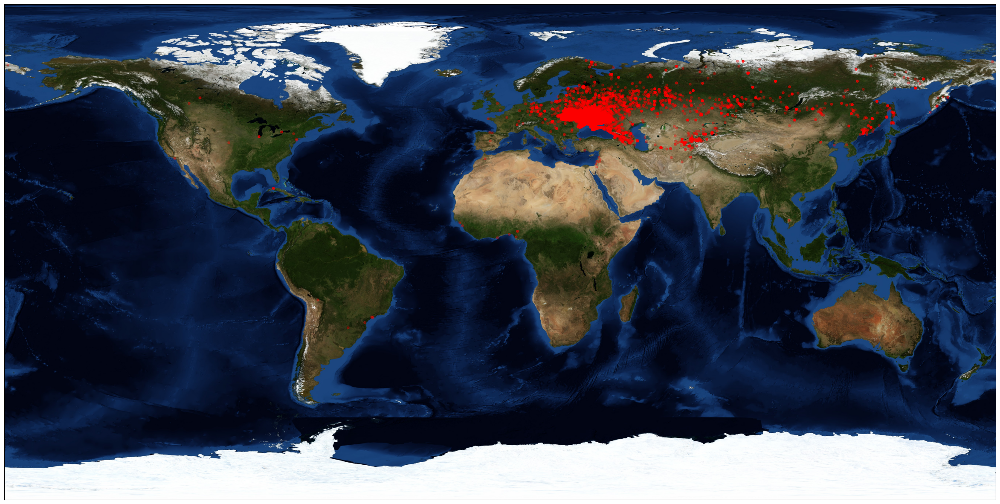

In [15]:
def draw_map(m, scale=0.2):
    # draw a shaded-relief image
    m.shadedrelief(scale=scale)
    
    # lats and longs are returned as a dictionary
    lats = m.drawparallels(np.linspace(-90, 90, 13))
    lons = m.drawmeridians(np.linspace(-180, 180, 13))

    # keys contain the plt.Line2D instances
    lat_lines = chain(*(tup[1][0] for tup in lats.items()))
    lon_lines = chain(*(tup[1][0] for tup in lons.items()))
    all_lines = chain(lat_lines, lon_lines)
    
    # cycle through these lines and set the desired style
    for line in all_lines:
        line.set(linestyle='-', alpha=0.3, color='w')

fig = plt.figure(figsize=(30, 20), edgecolor='w')
m = Basemap(projection='cyl', resolution=None,
            llcrnrlat=-90, urcrnrlat=90,
            llcrnrlon=-180, urcrnrlon=180)
m.bluemarble()
plt.scatter(cord_noise_df.Long2.values, cord_noise_df.Lat2.values, s=15, alpha=0.3, c='r')

plt.show()

### Interactive Visualisation with Pydeck

In [19]:
### Create syntetic variable coordinates
cord_df2 = cord_noise_df[['Long2','Lat2','PersonName','BirthPlace','Birthday', 'WikipediaURL']]
cord_df2['coordinates'] = [[x,y] for x,y in zip(cord_df2.Long2, cord_df2.Lat2)]
cord_df2 = cord_df2.rename(columns={'Lat2':'Latitude', 'Long2':'Longitude'})


layer = pdk.Layer(
    "ScatterplotLayer",
    cord_df2,
    pickable=True,
    opacity=0.5,
    stroked=True,
    filled=True,
    extruded=True,
    wireframe=True,
    auto_highlight=True,
    radius_scale=15,
    radius_min_pixels=1.3,
    radius_max_pixels=10,
    line_width_min_pixels=1,
    get_position="coordinates",
    #get_radius="exits_radius",
    get_fill_color=[255, 140, 0],
    get_line_color=[0, 0, 0],
    #on_click=on_click()
)

# Set the viewport location
view_state = pdk.ViewState(
    longitude=70,
    latitude=52,
    zoom=2,
    min_zoom=0,
    max_zoom=20,
#    pitch=40.5,
#    bearing=-27.36,
)
tooltip = {"html": """<b>Ім'я:</b>{PersonName}<br /><b>Місце народження:</b>{BirthPlace}<br /><b>Дата народження:</b>{Birthday}<br /><b>
                        Довгота:</b>{Longitude}<br /><b>Широта:</b> {Latitude}
                        """
          }

r = pdk.Deck(layers=[layer], initial_view_state=view_state, tooltip=tooltip)

### Save to html
r.to_html("index.html")